<a href="https://colab.research.google.com/github/MominAhmedShaikh/ANN-model-Regression/blob/main/ANN_video_games.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing dependencies and importing libraries

In [1]:
!pip install -U keras-tuner -q
!pip install -U imblearn -q
!pip install -U scikeras -q
!pip install -U kaleido -q

     |████████████████████████████████| 135 kB 23.0 MB/s 
     |████████████████████████████████| 1.6 MB 22.6 MB/s 
     |████████████████████████████████| 79.9 MB 117 kB/s 


In [2]:
from sklearn.metrics import classification_report,confusion_matrix,ConfusionMatrixDisplay
from sklearn.metrics import roc_auc_score,precision_score,accuracy_score,recall_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from scikeras.wrappers import KerasClassifier
from tensorflow.keras import layers
from sklearn.model_selection import GridSearchCV
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,BatchNormalization,Dropout
from imblearn.over_sampling import SMOTE
from keras import regularizers
from tensorflow import keras
from keras import models
import kaleido
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.figure_factory as ff
import tensorflow as tf
import seaborn as sns
import pandas as pd
import numpy as np
import keras_tuner
import plotly.graph_objects as go
from sklearn.impute import SimpleImputer
tf.random.set_seed(1) #setting seed to keep the environment equal

# Function Definations

In [3]:
def build_model(hp):
  model = keras.Sequential()

  model.add(keras.layers.Dense(
      hp.Choice('units', [12, 14, 16]),
      activation='relu'))
  
  model.add(keras.layers.Dense(
      hp.Choice('units', [8, 7, 6]),
      activation='relu'))
  
  model.add(keras.layers.Dense(1, activation='linear'))
  model.compile(loss='mse',optimizer='sgd',metrics=[tf.keras.metrics.RootMeanSquaredError()])
  return model

In [4]:
def model_training_regression(model):
  model.compile(
    optimizer='sgd',
    loss='mse',
    metrics=[tf.keras.metrics.RootMeanSquaredError()])
  
  history = model.fit(x_train
                       , y_train
                       , epochs=epochs
                       , batch_size=batch_size
                       , validation_data=(x_test, y_test)
                       , verbose=0
                       , callbacks = callback
        )
  print(model.evaluate(x_test,y_test))

  return history

In [5]:
def model_plots_regression(model):

  n = pd.DataFrame(model.history)

  fig = px.line(n, x=[i for i in model.epoch], y=["loss",'val_loss'], title='Loss Curve', height=300,width=500)
  fig.show()

  fig = px.line(n, x=[i for i in model.epoch], y=["root_mean_squared_error",'val_root_mean_squared_error'], title='RMSE Curve', height=300,width=630)
  fig.show('svg')

  return n



In [6]:
def model_prediction_regression(model,name='Model'):
  y_test[f'Global_sales_{name}'] = model.predict(x_test)
  return y_test

In [7]:
def top_sales_sum(df,col1,col2,top_value):
  his = px.histogram(data_frame=df,
                     x = [i for i in df.groupby(col1)[col2].sum().sort_values()[top_value:].index],
                      y = [df.groupby(col1)[col2].sum().sort_values()[top_value:].values])
  return his.show('svg')

In [8]:
def uni_cat_col(df,col):
  his = px.histogram(data_frame=df,
             x = [i for i in df[col].value_counts().index] ,
             y = [df[col].value_counts()[i] for i in range(len(df[col].value_counts().index))])
  return his.show('svg')

In [9]:
def missing_value_plot(ds):
  x = [i for i in ds.columns]
  y1 = [len(ds) for i in range(len(ds.columns))]
  y2 = [ds.isnull().sum()[i] for i in range(len(ds.columns))]
  y1 = np.array(y1)-np.array(y2)

  fig = go.Figure(data=[
      go.Bar(name='Total values', x=x, y=y1),
      go.Bar(name='Missing values', x=x, y=y2)
  ])
  # Change the bar mode
  fig.update_layout(barmode='stack')
  fig.show('svg')

In [10]:
def kdeplot_for_missing_impute(df,col_name,title):
  from statistics import mode

  # Create a subset
  x = df[[col_name]]

  # Assing differently imputed values to different columns
  x['Mean'] = df[col_name].fillna(df[col_name].mean())
  x['Median'] = df[col_name].fillna(df[col_name].median())
  x['Mode'] = df[col_name].fillna(mode(df[col_name]))

  # Obtain summary statistics
  x.describe().T[['mean', 'std', 'min', '50%', 'max']]

  x.plot(kind='kde', figsize=(12, 7), title=title)
  plt.show()
  return   x.describe().T[['mean', 'std', 'min', '50%', 'max']]

In [11]:
def knn_impute_plot(df,column_name):
  from statistics import mode
  x = df[[column_name]].copy()
  x[str(column_name)+'_KNN'] = imputed_orig[column_name]
  x[str(column_name)+'_KNN_Scaled'] = imputed_scaled[column_name]
  x['Mean'] = df[column_name].fillna(df[column_name].mean())
  x['Median'] = df[column_name].fillna(df[column_name].median())
  x['Mode'] = df[column_name].fillna(mode(df[column_name]))

  x.plot(kind = 'kde', figsize = (10,5))
  plt.show()
  # Obtain summary statistics
  return x.describe(include = 'all').T[['mean', 'std', 'min', '50%', '25%', '75%', 'max']]

# Data Processing And Preparation

#### Reading dataset

In [12]:
url = 'https://raw.githubusercontent.com/MominAhmedShaikh/ANN-model-Regression/main/dataset/video_games_sales.csv'
vg_ds = pd.read_csv(url)

#### .head()
- Global Sales is our Target Column.
- There are five columns correponds to Sale.
- Nan values in columns such as Critic_Score, Critic_Count, User_Score, User_Count, Developer	Rating are clearly visible.

In [13]:
vg_ds.head()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
0,Wii Sports,Wii,2006.0,Sports,Nintendo,41.36,28.96,3.77,8.45,82.53,76.0,51.0,8,322.0,Nintendo,E
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,NaN,NaN,NaN,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.68,12.76,3.79,3.29,35.52,82.0,73.0,8.3,709.0,Nintendo,E
3,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.61,10.93,3.28,2.95,32.77,80.0,73.0,8,192.0,Nintendo,E
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,NaN,NaN,NaN,NaN,NaN,NaN


#### .shape()
- The Dataset has 16719 columns and 16 rows

In [14]:
vg_ds.shape

(16719, 16)

#### .describe()
- Mean Global sales is 0.5335, which is greater then rest of the columns correspond to sales.
- Min Global sale was 0.01 and Max was 82.53, which may describe us which developer earned less or more, when we move to further steps in EDA.
- Year of Release ranges from 1980 to 2020 (40 years).

In [15]:
vg_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
Year_of_Release,16450.0,2006.487356,5.878995,1980.00,2003.00,2007.00,2010.00,2020.00
NA_Sales,16719.0,0.263330,0.813514,0.00,0.00,0.08,0.24,41.36
EU_Sales,16719.0,0.145025,0.503283,0.00,0.00,0.02,0.11,28.96
JP_Sales,16719.0,0.077602,0.308818,0.00,0.00,0.00,0.04,10.22
Other_Sales,16719.0,0.047332,0.186710,0.00,0.00,0.01,0.03,10.57
Global_Sales,16719.0,0.533543,1.547935,0.01,0.06,0.17,0.47,82.53
Critic_Score,8137.0,68.967679,13.938165,13.00,60.00,71.00,79.00,98.00
Critic_Count,8137.0,26.360821,18.980495,3.00,12.00,21.00,36.00,113.00
User_Count,7590.0,162.229908,561.282326,4.00,10.00,24.00,81.00,10665.00


#### .isnull() 
- Total Number of Missing values in Dataset is 46716.
- User Count has Max Number of Missing values about 9129 (54.60%).
- There are 6 columns with more then 40% of null values.

##### Null value summary

In [16]:
vg_ds.isnull().sum()

Name                  2
Platform              0
Year_of_Release     269
Genre                 2
Publisher            54
NA_Sales              0
EU_Sales              0
JP_Sales              0
Other_Sales           0
Global_Sales          0
Critic_Score       8582
Critic_Count       8582
User_Score         6704
User_Count         9129
Developer          6623
Rating             6769
dtype: int64

In [17]:
vg_ds.isnull().mean() * 100

Name                0.011962
Platform            0.000000
Year_of_Release     1.608948
Genre               0.011962
Publisher           0.322986
NA_Sales            0.000000
EU_Sales            0.000000
JP_Sales            0.000000
Other_Sales         0.000000
Global_Sales        0.000000
Critic_Score       51.330821
Critic_Count       51.330821
User_Score         40.098092
User_Count         54.602548
Developer          39.613613
Rating             40.486871
dtype: float64

In [18]:
vg_ds.isnull().sum().sum()

46716

##### Dealing with NULL values

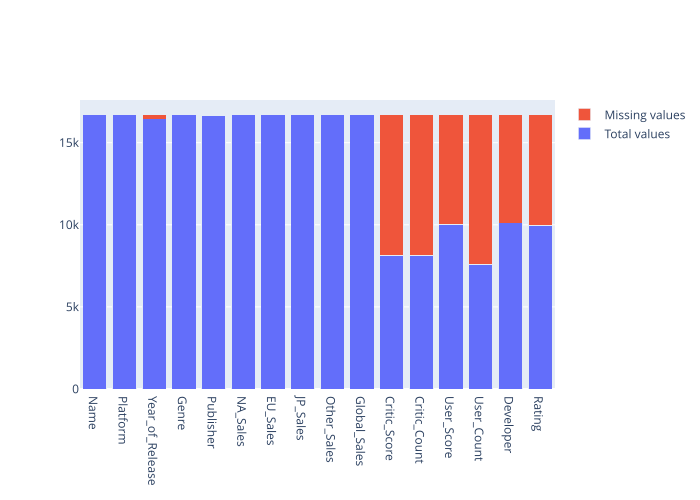

In [19]:
missing_value_plot(vg_ds)

In [20]:
# We can see that few columns conatin 50% null value per row and also their global sales is less than 0.10 we can 
vg_ds[vg_ds.isnull().any(axis = 1)].tail()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
16714,Samurai Warriors: Sanada Maru,PS3,2016.0,Action,Tecmo Koei,0.00,0.00,0.01,0.0,0.01,NaN,NaN,NaN,NaN,NaN,NaN
16715,LMA Manager 2007,X360,2006.0,Sports,Codemasters,0.00,0.01,0.00,0.0,0.01,NaN,NaN,NaN,NaN,NaN,NaN
16716,Haitaka no Psychedelica,PSV,2016.0,Adventure,Idea Factory,0.00,0.00,0.01,0.0,0.01,NaN,NaN,NaN,NaN,NaN,NaN
16717,Spirits & Spells,GBA,2003.0,Platform,Wanadoo,0.01,0.00,0.00,0.0,0.01,NaN,NaN,NaN,NaN,NaN,NaN
16718,Winning Post 8 2016,PSV,2016.0,Simulation,Tecmo Koei,0.00,0.00,0.01,0.0,0.01,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
nan_vals = vg_ds[vg_ds['Global_Sales'] < 0.1].isnull()
vg_ds = vg_ds.drop(nan_vals.index)

In [22]:
vg_ds.shape

(10827, 16)

###### Rating Column Null Value Imputation
- Imputing Rating column with its mode 'E' will make column's distribution more centric towards one value. Hence we will replace it with Arbitrary value 'NK' (Not Known).

In [23]:
vg_ds['Rating'].unique()

array(['E', nan, 'M', 'T', 'E10+', 'K-A', 'AO', 'EC'], dtype=object)

In [24]:
imputer = SimpleImputer(strategy='constant',fill_value='NK')
vg_ds['Rating'] = imputer.fit_transform(vg_ds[['Rating']])

###### Developer Column Null Value Imputation
- Imputing Developer column with its mode 'Nitendo' will make column's distribution more centric towards one value. Hence we will replace it with Arbitrary value 'Not Known'

In [25]:
vg_ds['Developer'].unique()

array(['Nintendo', nan, 'Good Science Studio', ..., 'B.B.Studio',
       'Scientifically Proven', '8Monkey Labs'], dtype=object)

In [26]:
imputer = SimpleImputer(strategy='constant',fill_value='Not known')
vg_ds['Developer'] = imputer.fit_transform(vg_ds[['Developer']])

###### Year_of_Release Null Value Imputation
- Imputing Year_of_Release column with its median 2007 will make column's distribution more centric.
- Mean and mode of Year_of_Release was 2006 , 2008 respectively.

In [27]:
imputer = SimpleImputer(strategy='median',missing_values=np.nan)
vg_ds['Year_of_Release'] = imputer.fit_transform(vg_ds[['Year_of_Release']])

###### Genre Null Value Imputation
- Though Genre has only one missing value, But we will still impute it with mode.

In [28]:
imputer = SimpleImputer(strategy='most_frequent',missing_values=np.nan)
vg_ds['Genre'] = imputer.fit_transform(vg_ds[['Genre']])

###### Publisher Null Value Imputation
- Publisher has 32 Null values, we will impute it with mode.

In [29]:
imputer = SimpleImputer(strategy='most_frequent',missing_values=np.nan)
vg_ds['Publisher'] = imputer.fit_transform(vg_ds[['Publisher']])

##### User Score datatype conversion
- User_Score is in object datatype but we will convert it into float datatype.
- We were unable to convert this User_Score column to float64 directly because it had 1 str value 'tbd'.
- First we need to handle this value then we can convert this column's datatype to float64.
- Occurance of 'tbd' is 2425 which is 14.5% of whole column.
- We can follow either of the two ways
 - We can convert this value into some Arbitrary value.
 - We can convert this value into Nan values and later treat them with Nan Values.
- We will follow second appraoch as we don't know much about data.

In [30]:
vg_ds['User_Score'].unique()

array(['8', nan, '8.3', '8.5', '6.6', '8.4', '8.6', '7.7', '6.3', '7.4',
       '8.2', '9', '7.9', '8.1', '8.7', '7.1', '3.4', '5.3', '4.8', '3.2',
       '8.9', '6.4', '7.8', '7.5', '2.6', '7.2', '9.2', '7', '7.3', '4.3',
       '7.6', '5.7', '5', '9.1', '6.5', 'tbd', '8.8', '6.9', '9.4', '6.8',
       '6.1', '6.7', '5.4', '4', '4.9', '4.5', '9.3', '6.2', '4.2', '6',
       '3.7', '4.1', '5.8', '5.6', '5.5', '4.4', '4.6', '5.9', '3.9',
       '3.1', '2.9', '5.2', '3.3', '4.7', '5.1', '3.5', '2.5', '1.9', '3',
       '2.7', '2.2', '2', '9.5', '2.1', '3.6', '2.8', '1.8', '3.8', '0',
       '1.6', '9.6', '2.4', '1.7', '1.1', '0.3', '1.5', '0.7', '1.2',
       '2.3', '0.5', '1.3', '0.2', '0.6', '1.4', '0.9'], dtype=object)

In [31]:
count = 0
for i in vg_ds['User_Score']:
  if i == 'tbd':
    count += 1
count

1302

In [32]:
vg_ds['User_Score'] = vg_ds['User_Score'].replace('tbd',np.nan)

In [33]:
vg_ds['User_Score'].unique()

array(['8', nan, '8.3', '8.5', '6.6', '8.4', '8.6', '7.7', '6.3', '7.4',
       '8.2', '9', '7.9', '8.1', '8.7', '7.1', '3.4', '5.3', '4.8', '3.2',
       '8.9', '6.4', '7.8', '7.5', '2.6', '7.2', '9.2', '7', '7.3', '4.3',
       '7.6', '5.7', '5', '9.1', '6.5', '8.8', '6.9', '9.4', '6.8', '6.1',
       '6.7', '5.4', '4', '4.9', '4.5', '9.3', '6.2', '4.2', '6', '3.7',
       '4.1', '5.8', '5.6', '5.5', '4.4', '4.6', '5.9', '3.9', '3.1',
       '2.9', '5.2', '3.3', '4.7', '5.1', '3.5', '2.5', '1.9', '3', '2.7',
       '2.2', '2', '9.5', '2.1', '3.6', '2.8', '1.8', '3.8', '0', '1.6',
       '9.6', '2.4', '1.7', '1.1', '0.3', '1.5', '0.7', '1.2', '2.3',
       '0.5', '1.3', '0.2', '0.6', '1.4', '0.9'], dtype=object)

In [34]:
vg_ds['User_Score'] = vg_ds['User_Score'].astype(float)

In [35]:
vg_ds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10827 entries, 0 to 10826
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             10826 non-null  object 
 1   Platform         10827 non-null  object 
 2   Year_of_Release  10827 non-null  float64
 3   Genre            10827 non-null  object 
 4   Publisher        10827 non-null  object 
 5   NA_Sales         10827 non-null  float64
 6   EU_Sales         10827 non-null  float64
 7   JP_Sales         10827 non-null  float64
 8   Other_Sales      10827 non-null  float64
 9   Global_Sales     10827 non-null  float64
 10  Critic_Score     6092 non-null   float64
 11  Critic_Count     6092 non-null   float64
 12  User_Score       5882 non-null   float64
 13  User_Count       5882 non-null   float64
 14  Developer        10827 non-null  object 
 15  Rating           10827 non-null  object 
dtypes: float64(10), object(6)
memory usage: 1.4+ MB


##### User_Score , User_Count , Critic_Score , Critic_Count Null Value Imputaion

In [36]:
vg_ds.isnull().sum()

Name                  1
Platform              0
Year_of_Release       0
Genre                 0
Publisher             0
NA_Sales              0
EU_Sales              0
JP_Sales              0
Other_Sales           0
Global_Sales          0
Critic_Score       4735
Critic_Count       4735
User_Score         4945
User_Count         4945
Developer             0
Rating                0
dtype: int64

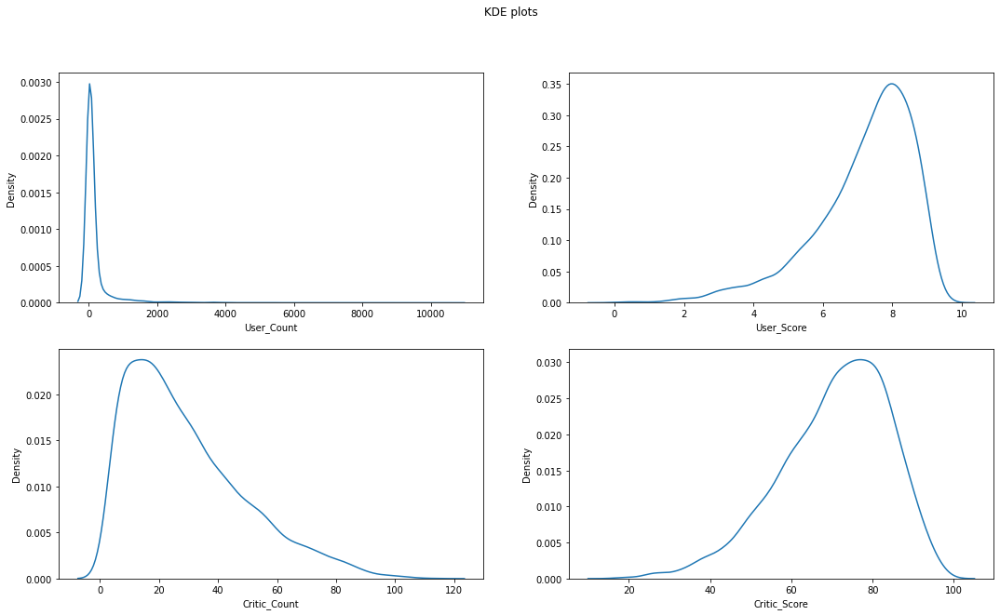

In [37]:
cols = ['Critic_Score','Critic_Count','User_Score','User_Count']

#define plotting region (2 rows, 2 columns)
fig, axes = plt.subplots(2, 2,figsize=(18, 10))
sns.kdeplot(vg_ds['User_Count'],ax = axes[0,0])
sns.kdeplot(vg_ds['User_Score'],ax = axes[0,1])
sns.kdeplot(vg_ds['Critic_Count'],ax = axes[1,0])
sns.kdeplot(vg_ds['Critic_Score'],ax = axes[1,1])
plt.suptitle("KDE plots")
plt.show()

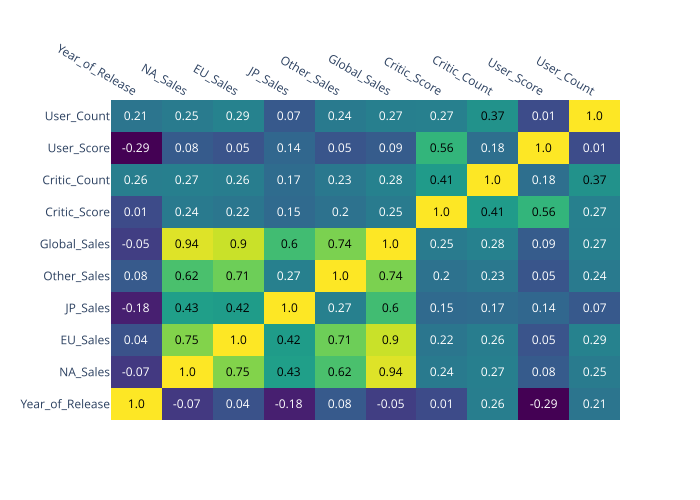

In [38]:
# the corr is less between columns hence we will not use iterative imputer
x = list(vg_ds.corr().columns)
y = list(vg_ds.corr().index)
z = np.array(vg_ds.corr())

fig = ff.create_annotated_heatmap(
    z,
    x = x,
    y = y ,
    annotation_text = np.around(z, decimals=2),
    hoverinfo='z',
    colorscale='Viridis'
    )
fig.show('svg')

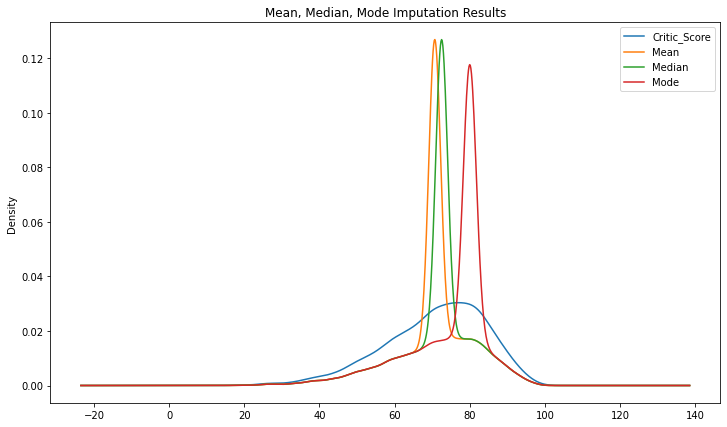

,mean,std,min,50%,max
Critic_Score,70.667269,13.457965,17.0,72.500000,98.0
Mean,70.667269,10.094613,17.0,70.667269,98.0
Median,71.468782,10.135474,17.0,72.500000,98.0
Mode,74.748776,11.105679,17.0,80.000000,98.0


In [39]:
kdeplot_for_missing_impute(vg_ds,'Critic_Score','Mean, Median, Mode Imputation Results')

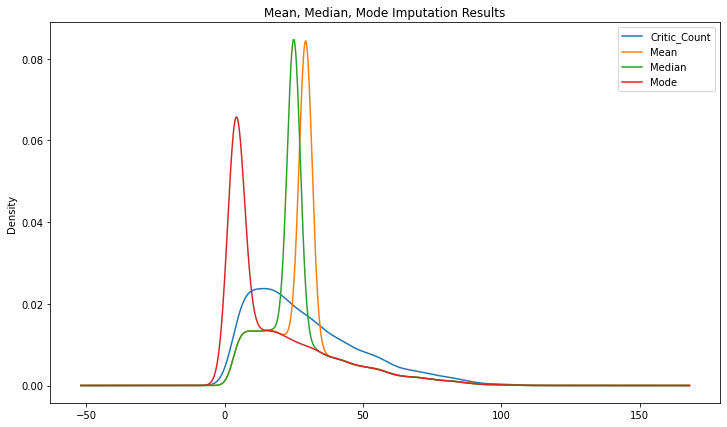

,mean,std,min,50%,max
Critic_Count,29.275772,19.985542,3.0,25.000000,113.0
Mean,29.275772,14.990849,3.0,29.275772,113.0
Median,27.405837,15.140169,3.0,25.000000,113.0
Mode,18.221853,19.543471,3.0,8.000000,113.0


In [40]:
kdeplot_for_missing_impute(vg_ds,'Critic_Count','Mean, Median, Mode Imputation Results')

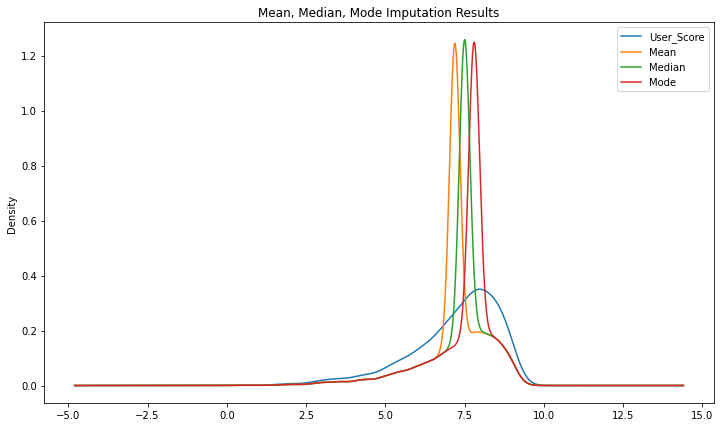

,mean,std,min,50%,max
User_Score,7.190751,1.439805,0.0,7.500000,9.6
Mean,7.190751,1.061195,0.0,7.190751,9.6
Median,7.331994,1.072318,0.0,7.500000,9.6
Mode,7.469013,1.103741,0.0,7.800000,9.6


In [41]:
kdeplot_for_missing_impute(vg_ds,'User_Score','Mean, Median, Mode Imputation Results')

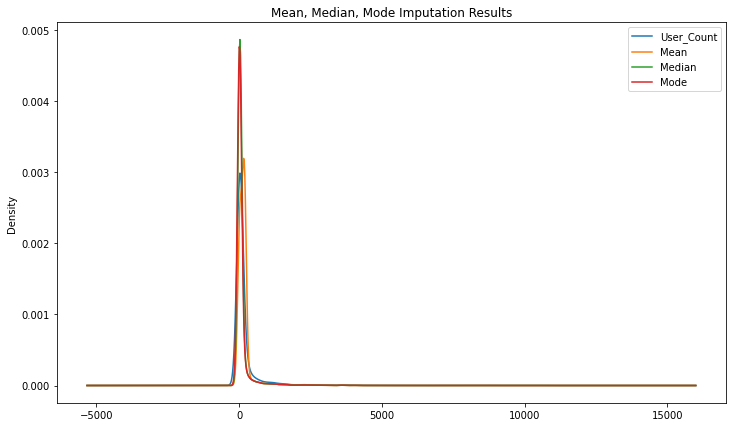

,mean,std,min,50%,max
User_Count,184.327780,608.288117,4.0,28.00000,10665.0
Mean,184.327780,448.333211,4.0,184.32778,10665.0
Median,112.928420,455.046220,4.0,28.00000,10665.0
Mode,102.880392,457.049288,4.0,6.00000,10665.0


In [42]:
kdeplot_for_missing_impute(vg_ds,'User_Count','Mean, Median, Mode Imputation Results')

In [43]:
num_col = []
for i in vg_ds.columns:
  if vg_ds[i].dtype==float:
    num_col.append(i)

    
from sklearn.preprocessing import MinMaxScaler
new_ds = vg_ds.drop(columns=[i for i in vg_ds.columns if i not in num_col])
# Original dataset
data_original = new_ds

# Scaled dataset
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(data_original)
data_scaled = pd.DataFrame(data=data_scaled, columns=data_original.columns)
data_scaled.head()

,Year_of_Release,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count
0,0.650,1.000000,1.000000,0.368885,0.799432,1.000000,0.728395,0.436364,0.833333,0.029828
1,0.125,0.703095,0.123619,0.666341,0.072848,0.486959,NaN,NaN,NaN,NaN
2,0.700,0.379110,0.440608,0.370841,0.311258,0.429698,0.802469,0.636364,0.864583,0.066129
3,0.725,0.377418,0.377417,0.320939,0.279092,0.396336,0.777778,0.636364,0.833333,0.017634
4,0.400,0.272485,0.306975,1.000000,0.094607,0.379352,NaN,NaN,NaN,NaN


In [44]:
from sklearn.impute import KNNImputer

# Impute
imputer_orig = KNNImputer(n_neighbors=3)
imputed_orig = imputer_orig.fit_transform(data_original)

imputer_scaled = KNNImputer(n_neighbors=3)
imputed_scaled = imputer_scaled.fit_transform(data_scaled)

# Convert to DataFrames
imputed_orig = pd.DataFrame(data=imputed_orig, columns=data_original.columns)
imputed_scaled = pd.DataFrame(data=imputed_scaled, columns=data_original.columns)

# Inverse the scaling
imputed_scaled = scaler.inverse_transform(imputed_scaled)
imputed_scaled = pd.DataFrame(data=imputed_scaled, columns=data_original.columns)

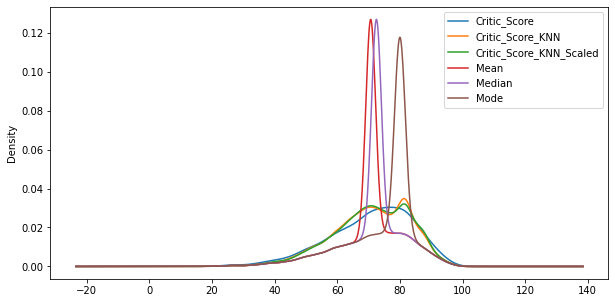

,mean,std,min,50%,25%,75%,max
Critic_Score,70.667269,13.457965,17.0,72.500000,62.000000,81.0,98.0
Critic_Score_KNN,70.872449,12.367387,17.0,72.000000,63.000000,81.0,98.0
Critic_Score_KNN_Scaled,70.921770,12.407628,17.0,72.000000,63.000000,81.0,98.0
Mean,70.667269,10.094613,17.0,70.667269,70.667269,74.0,98.0
Median,71.468782,10.135474,17.0,72.500000,71.000000,74.0,98.0
Mode,74.748776,11.105679,17.0,80.000000,71.000000,80.0,98.0


In [45]:
knn_impute_plot(vg_ds,'Critic_Score')

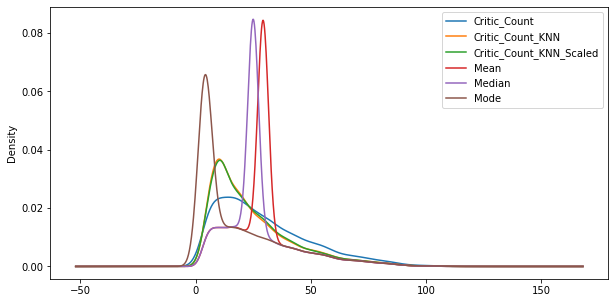

,mean,std,min,50%,25%,75%,max
Critic_Count,29.275772,19.985542,3.0,25.000000,14.0,41.000000,113.0
Critic_Count_KNN,24.411625,17.917840,3.0,19.000000,11.0,33.000000,113.0
Critic_Count_KNN_Scaled,24.566547,17.840681,3.0,19.333333,11.0,33.000000,113.0
Mean,29.275772,14.990849,3.0,29.275772,22.0,29.275772,113.0
Median,27.405837,15.140169,3.0,25.000000,22.0,28.000000,113.0
Mode,18.221853,19.543471,3.0,8.000000,4.0,28.000000,113.0


In [46]:
knn_impute_plot(vg_ds,'Critic_Count')

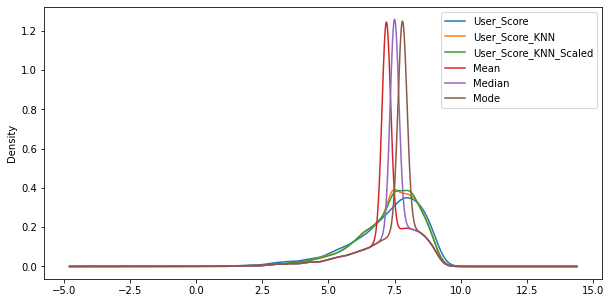

,mean,std,min,50%,25%,75%,max
User_Score,7.190751,1.439805,0.0,7.500000,6.500000,8.200000,9.6
User_Score_KNN,7.249571,1.273024,0.0,7.466667,6.600000,8.200000,9.6
User_Score_KNN_Scaled,7.248188,1.282149,0.0,7.500000,6.600000,8.166667,9.6
Mean,7.190751,1.061195,0.0,7.190751,7.190751,7.600000,9.6
Median,7.331994,1.072318,0.0,7.500000,7.400000,7.600000,9.6
Mode,7.469013,1.103741,0.0,7.800000,7.400000,7.800000,9.6


In [47]:
knn_impute_plot(vg_ds,'User_Score')

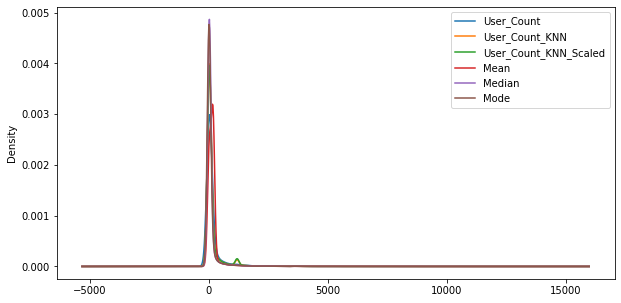

,mean,std,min,50%,25%,75%,max
User_Count,184.327780,608.288117,4.0,28.000000,12.000000,93.750000,10665.0
User_Count_KNN,162.049691,507.963254,4.0,24.000000,10.666667,75.166667,10665.0
User_Count_KNN_Scaled,166.549706,509.185143,4.0,25.333333,11.000000,79.000000,10665.0
Mean,184.327780,448.333211,4.0,184.327780,24.000000,184.327780,10665.0
Median,112.928420,455.046220,4.0,28.000000,24.000000,33.000000,10665.0
Mode,102.880392,457.049288,4.0,6.000000,6.000000,33.000000,10665.0


In [48]:
knn_impute_plot(vg_ds,'User_Count')

In [49]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=3)
for i in cols:
  vg_ds[i] = imputer.fit_transform(vg_ds[[i]])

#### .info()
- There are 7 and 9 columns of object and float64 datatype.

##### Year Column datatype Conversion

In [50]:
vg_ds['Year_of_Release'] = vg_ds['Year_of_Release'].astype(int)

In [51]:
vg_ds['Year_of_Release'][0:5]

0    2006
1    1985
2    2008
3    2009
4    1996
Name: Year_of_Release, dtype: int64

#### .unique()
- Name column has many unique values, which won't be needed during our model building process. Hence, we will drop this column.
- The least number of unique value per column is 8 which is in Rating column.
- The maximum number of unique values is in Developer column. There are numerous ways we can deal with these types of column, such as some developer have only contributed 1 time in whole dataset, we can group values which belongs to 1-5 and bin them into new group or we can leave the column as it is.
- We will need to encode these columns by Frequency/Count encoder or we can use Ordinal encoder from scikit learn library to encode such number of unique values per column.

In [52]:
vg_ds_nunique = {i : vg_ds[i].nunique() for i in vg_ds.columns}
vg_ds_nunique

{'Name': 7382,
 'Platform': 28,
 'Year_of_Release': 38,
 'Genre': 12,
 'Publisher': 373,
 'NA_Sales': 402,
 'EU_Sales': 307,
 'JP_Sales': 244,
 'Other_Sales': 155,
 'Global_Sales': 620,
 'Critic_Score': 81,
 'Critic_Count': 107,
 'User_Score': 94,
 'User_Count': 834,
 'Developer': 1254,
 'Rating': 8}

In [53]:
vg_ds.drop(columns=['Name'],inplace = True)

#### .duplicated()
- There are 16 duplicate values in Dataset

In [54]:
vg_ds.duplicated().sum()

16

In [55]:
vg_ds.drop_duplicates(inplace = True)

# EDA


###### Object Column and Numerical Column Seperation

In [56]:
object_col = []
for i in vg_ds:
  if vg_ds[i].dtype == object:
    object_col.append(i)

In [57]:
object_col

['Platform', 'Genre', 'Publisher', 'Developer', 'Rating']

In [58]:
num_col

['Year_of_Release',
 'NA_Sales',
 'EU_Sales',
 'JP_Sales',
 'Other_Sales',
 'Global_Sales',
 'Critic_Score',
 'Critic_Count',
 'User_Score',
 'User_Count']

### Categorical Column Analysis
- Maximum no. of Games played on PS2
- Genre which outperformed every other genre was Action.
- Electronic Arts has Published max no. of games.
- Most of the developers and ratings given by users are unknown.

In [59]:
object_col

['Platform', 'Genre', 'Publisher', 'Developer', 'Rating']

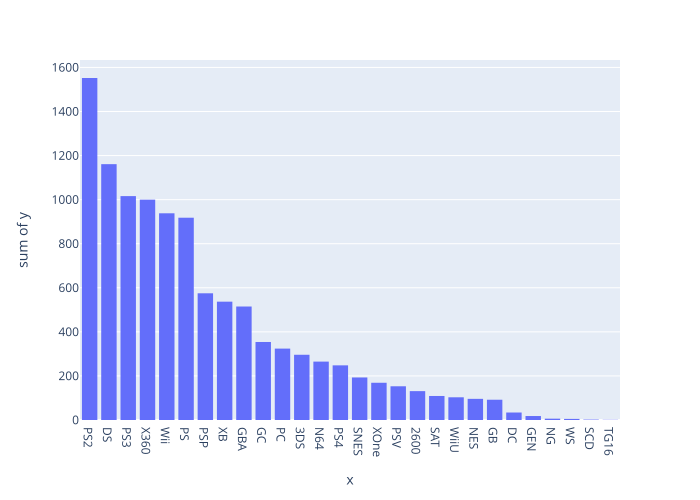

In [60]:
uni_cat_col(vg_ds,'Platform')

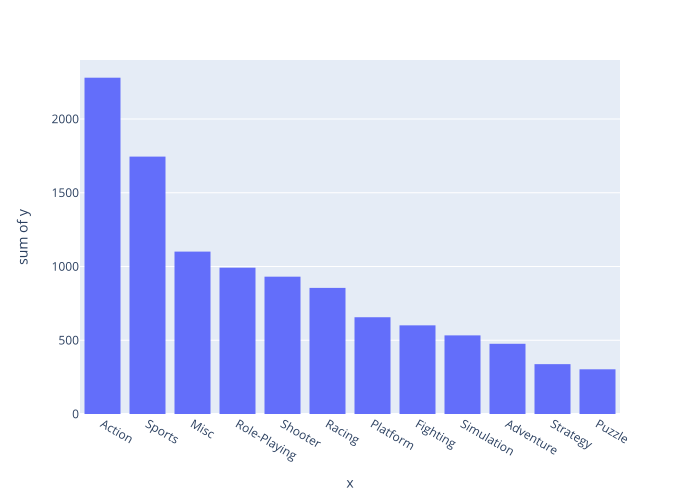

In [61]:
uni_cat_col(vg_ds,'Genre')

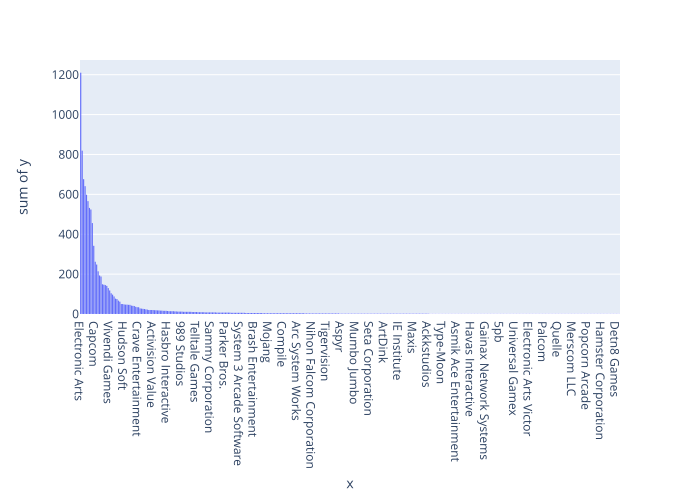

In [62]:
uni_cat_col(vg_ds,'Publisher')

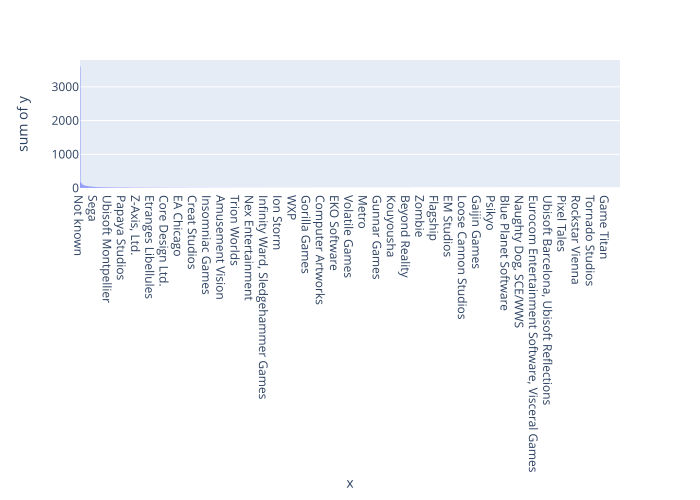

In [63]:
uni_cat_col(vg_ds,'Developer')

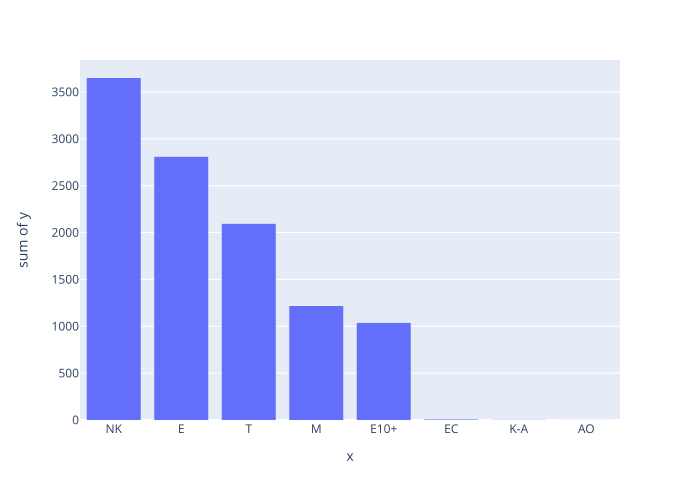

In [64]:
uni_cat_col(vg_ds,'Rating')

### Numerical column Analysis
- Global sales was in weak positive correlation with other sales columns, and also one more point to notice here is global sales is addition of all other sales features.
- Most of the columns with Years showed that after end of 20th centuary User and Count count bagan to increase drastically.

In [65]:
fig = px.scatter_matrix(vg_ds,dimensions=[i for i in num_col])
fig.update_layout(
    title='Univariate Numerical Analysis',
    width=2000,
    height=2000
)
fig.update_traces(diagonal_visible=False)
fig.show('svg')

### Bivariate and Multivariate analysis

#### Group by Analysis
- We can perform Group by analysis with other sales column also but we will take only global sales as it is out target column.
- PS2 had Max no. of global sales around 1200.
- Action was the most sold genre.
- Nitendo had published most number of games.

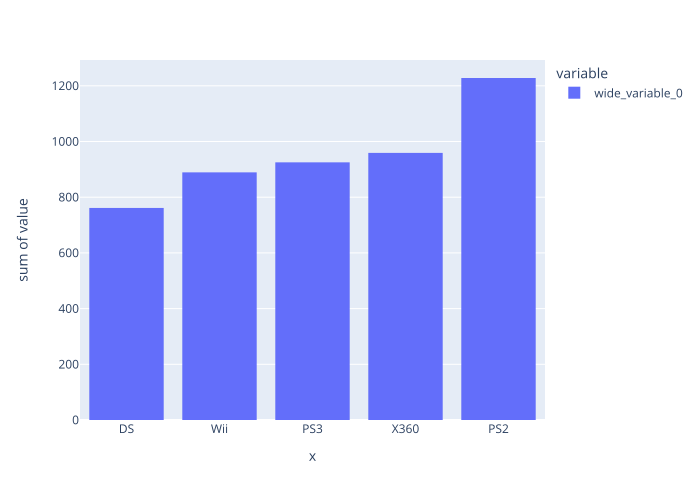

In [66]:
top_sales_sum(vg_ds,'Platform','Global_Sales',-5)

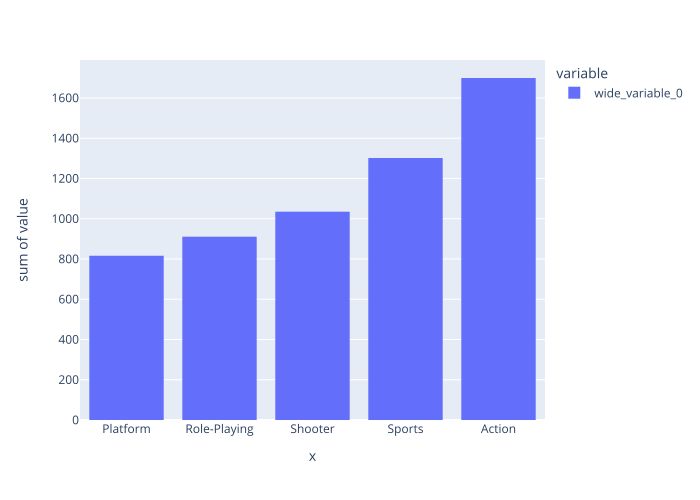

In [67]:
top_sales_sum(vg_ds,'Genre','Global_Sales',-5)

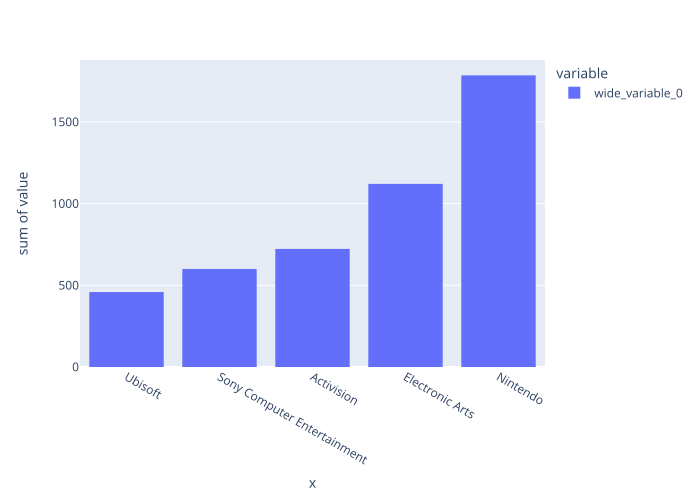

In [68]:
top_sales_sum(vg_ds,'Publisher','Global_Sales',-5)

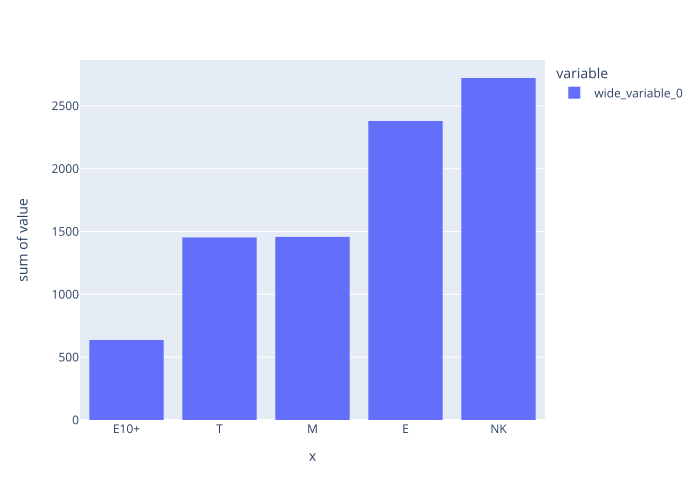

In [69]:
top_sales_sum(vg_ds,'Rating','Global_Sales',-5)

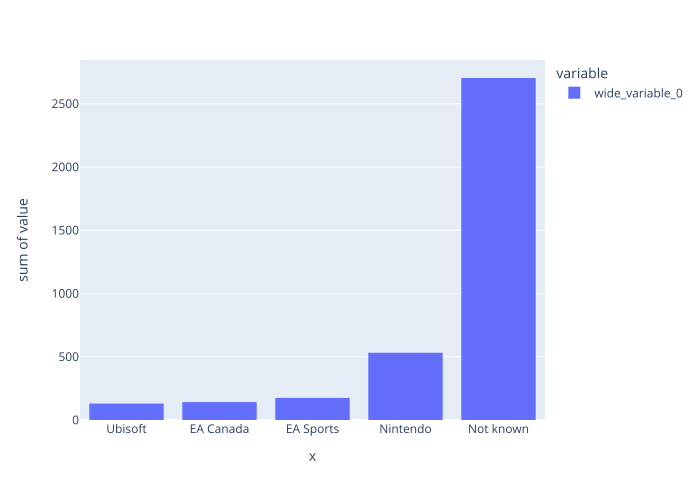

In [70]:
top_sales_sum(vg_ds,'Developer','Global_Sales',-5)

#### Box Plot
- Box plot shows User_count has most number of outliers. Which we will deal later on. Other columns are more centric towards 0.

In [71]:
fig = px.box(pd.melt(vg_ds), x="variable", y="value", points="outliers")
fig.show('svg')

#### Correlation Matrix
- Global sales had highest corr with NA_sales, EU_sales and other_sales.

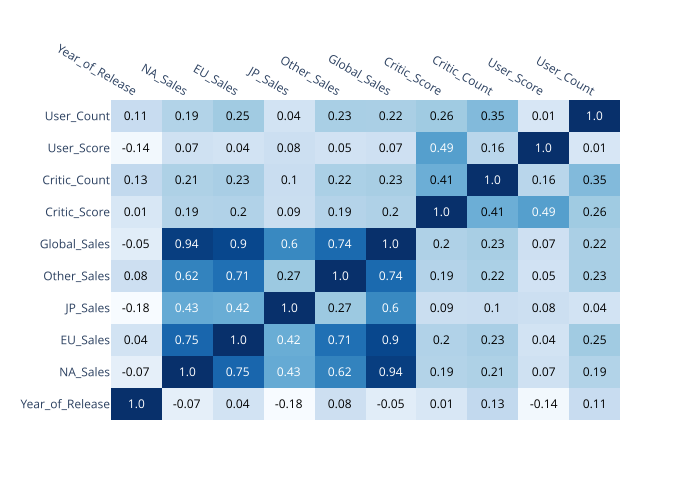

In [72]:
x = list(vg_ds.corr().columns)
y = list(vg_ds.corr().index)
z = np.array(vg_ds.corr())

fig = ff.create_annotated_heatmap(
    z,
    x = x,
    y = y ,
    annotation_text = np.around(z, decimals=2),
    hoverinfo='z',
    colorscale='Blues'
    )
fig.show('svg')

#### Distribution Plot
- Columns are not distributed evenly because of presence of outlier. but sales column suggest that as number of users increased after 2000, more people will purchase games. Hence, it should justify the number of outliers in dataset.

In [73]:
hist_data = [vg_ds[i].values for i in num_col]
group_labels = [i for i in num_col]
fig1 = ff.create_distplot(hist_data, group_labels, curve_type='normal',show_rug=True,show_hist=True)
fig1.show('svg')

# Model Building

### Encoding Object Variables
- We have used Ordinal Encoder as the number of unique values per column exceeds. And some columns are ordinal categorical column.

In [74]:
for i in object_col:
  print(i,'-->', vg_ds[i].nunique())

Platform --> 28
Genre --> 12
Publisher --> 373
Developer --> 1254
Rating --> 8


In [75]:
from sklearn.preprocessing import OrdinalEncoder
def Encode(df,column_name):
  copy = df[[column_name]]
  OE = OrdinalEncoder()
  df[column_name] = OE.fit_transform(df[[column_name]])
  c = {str(column_name) : copy.values.reshape(-1),str(column_name)+'_Encoded' : df[column_name].values.reshape(-1)}
  return pd.DataFrame(c)


In [76]:
Encode(vg_ds,'Platform')

,Platform,Platform_Encoded
0,Wii,23.0
1,NES,9.0
2,Wii,23.0
3,Wii,23.0
4,GB,4.0
...,...,...
10806,XOne,27.0
10807,XB,26.0
10808,PSP,16.0
10809,WiiU,24.0


In [77]:
Encode(vg_ds,'Genre')

,Genre,Genre_Encoded
0,Sports,10.0
1,Platform,4.0
2,Racing,6.0
3,Sports,10.0
4,Role-Playing,7.0
...,...,...
10806,Platform,4.0
10807,Action,0.0
10808,Racing,6.0
10809,Action,0.0


In [78]:
Encode(vg_ds,'Publisher')

,Publisher,Publisher_Encoded
0,Nintendo,222.0
1,Nintendo,222.0
2,Nintendo,222.0
3,Nintendo,222.0
4,Nintendo,222.0
...,...,...
10806,Activision,13.0
10807,Activision,13.0
10808,Electronic Arts,94.0
10809,Activision,13.0


In [79]:
Encode(vg_ds,'Developer')

,Developer,Developer_Encoded
0,Nintendo,749.0
1,Not known,765.0
2,Nintendo,749.0
3,Nintendo,749.0
4,Not known,765.0
...,...,...
10806,Toys for Bob,1118.0
10807,Treyarch,1122.0
10808,Exient Entertainment,379.0
10809,Not known,765.0


In [80]:
Encode(vg_ds,'Rating')

,Rating,Rating_Encoded
0,E,1.0
1,NK,6.0
2,E,1.0
3,E,1.0
4,NK,6.0
...,...,...
10806,E10+,2.0
10807,T,7.0
10808,E,1.0
10809,NK,6.0


### Spliting Dataset into train and test
- We have used train and test size 80 and 20 respectively.

In [81]:
x = vg_ds.drop(columns=['Global_Sales'])
y = vg_ds[['Global_Sales']]

In [82]:
x.shape,y.shape

((10811, 14), (10811, 1))

In [83]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,train_size=0.80,random_state=42)

### Scaling Dataset
- Scaling will help us manipulate outliers.

In [84]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x_train = sc.fit_transform(x_train)
x_test = sc.fit_transform(x_test)

In [85]:
len(x_train),len(x_test),len(y_train),len(y_test)

(8648, 2163, 8648, 2163)

### Model building
- callback - EarlyStopping
- epochs - 100
- batch size - 20 
- loss - MeanSquareError and RMSE
- optimizer - sgd


#### Variable definition

In [86]:
callback = callback = tf.keras.callbacks.EarlyStopping(
    monitor="root_mean_squared_error",
    min_delta=0,
    patience=5,
    verbose=2,
    mode="auto",
    baseline=None,
    restore_best_weights=False,
)
epochs = 100
accuracy = tf.keras.metrics.RootMeanSquaredError(
    name="root_mean_squared_error", dtype=None
)
batch_size = 20

#### Baseline Model
- We are defining this model to compare with other models and also to understand about how our model will perform under certain conditions.

In [87]:
base_model = models.Sequential()
base_model.add(layers.Dense(7, activation='relu', input_shape=(14,)))
base_model.add(layers.Dense(1, activation = 'linear'))
base_model._name = 'Baseline_model'
base_model.summary()

Model: "Baseline_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 7)                 105       
                                                                 
 dense_1 (Dense)             (None, 1)                 8         
                                                                 
Total params: 113
Trainable params: 113
Non-trainable params: 0
_________________________________________________________________


In [88]:
base_history = model_training_regression(base_model)

Epoch 51: early stopping
68/68 [==============================] - 0s 2ms/step - loss: 0.4940 - root_mean_squared_error: 0.7028
[0.49396297335624695, 0.7028250098228455]


In [89]:
base_model.evaluate(x_test,y_test)

68/68 [==============================] - 0s 1ms/step - loss: 0.4940 - root_mean_squared_error: 0.7028


[0.49396297335624695, 0.7028250098228455]

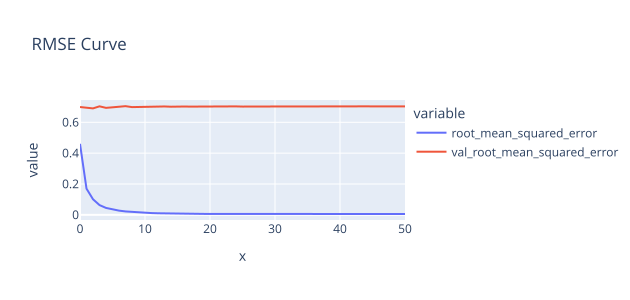

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,0.211963,0.460394,0.488636,0.699025
1,0.028890,0.169971,0.484406,0.695993
2,0.010218,0.101084,0.476285,0.690134
3,0.004017,0.063381,0.494885,0.703480
4,0.002024,0.044991,0.481137,0.693640
5,0.001177,0.034301,0.485932,0.697088
6,0.000753,0.027445,0.489418,0.699584
7,0.000494,0.022236,0.496481,0.704614
8,0.000340,0.018445,0.487785,0.698416
9,0.000242,0.015570,0.489862,0.699902


In [90]:
model_plots_regression(base_history)

#### L2 Regularized model
- kernel_regularizer - L2(0.001) is added in one layer

In [91]:
reg_model = models.Sequential()
reg_model.add(layers.Dense(7, kernel_regularizer=regularizers.l2(0.001), activation='relu', input_shape=(14,)))
reg_model.add(layers.Dense(1, activation='linear'))
reg_model._name = 'L2_Regularization_model'
reg_model.summary()

Model: "L2_Regularization_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 7)                 105       
                                                                 
 dense_3 (Dense)             (None, 1)                 8         
                                                                 
Total params: 113
Trainable params: 113
Non-trainable params: 0
_________________________________________________________________


In [92]:
reg_history = model_training_regression(reg_model)

68/68 [==============================] - 0s 1ms/step - loss: 0.4988 - root_mean_squared_error: 0.7050
[0.49882951378822327, 0.7050143480300903]


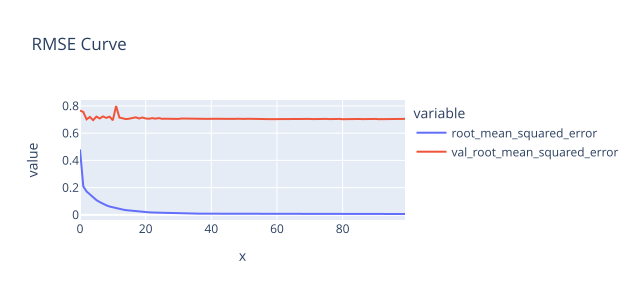

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,0.239227,0.480423,0.595939,0.766663
1,0.051844,0.209327,0.579004,0.755731
2,0.037240,0.171683,0.499640,0.701425
3,0.030060,0.150159,0.524388,0.719025
4,0.023725,0.128239,0.491125,0.695665
...,...,...,...,...
95,0.001922,0.006248,0.498194,0.704502
96,0.001899,0.006215,0.498875,0.705001
97,0.001876,0.006177,0.496949,0.703649
98,0.001855,0.006177,0.498962,0.705094


In [93]:
model_plots_regression(reg_history)

#### Batch Normalization model
- Batch Normalization layer was added at first layer.

In [94]:
Batch_norm_model = keras.Sequential()
Batch_norm_model.add(layers.Dense(7,input_shape = (14,),activation = 'relu'))
Batch_norm_model.add(layers.BatchNormalization())
Batch_norm_model.add(layers.Dense(1,activation = 'linear'))

In [95]:
Batch_norm_history = model_training_regression(Batch_norm_model)

Epoch 38: early stopping
68/68 [==============================] - 0s 1ms/step - loss: 0.3080 - root_mean_squared_error: 0.5550
[0.30801475048065186, 0.5549907684326172]


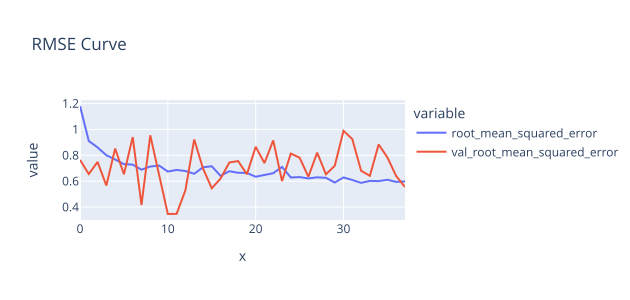

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,1.394527,1.180901,0.584539,0.764551
1,0.828827,0.910400,0.429538,0.655392
2,0.741186,0.860922,0.560404,0.748601
3,0.640829,0.800518,0.320800,0.566392
4,0.589280,0.767646,0.726458,0.852325
5,0.535318,0.731654,0.427341,0.653713
6,0.530040,0.728038,0.884735,0.940603
7,0.474667,0.688961,0.173582,0.416632
8,0.508687,0.713223,0.910814,0.954366
9,0.519796,0.720969,0.438489,0.662185


In [96]:
model_plots_regression(Batch_norm_history)

#### Dropout layer model
- Dropout layer is added to first layer

In [97]:
Dropout_model = keras.Sequential()
Dropout_model.add(layers.Dense(7,input_shape = (14,),activation = 'relu'))
Dropout_model.add(layers.Dropout(0.01))
Dropout_model.add(layers.Dense(1,activation = 'linear'))

In [98]:
Dropout_history = model_training_regression(Dropout_model)

Epoch 18: early stopping
68/68 [==============================] - 0s 1ms/step - loss: 0.4984 - root_mean_squared_error: 0.7060
[0.4983818829059601, 0.7059616446495056]


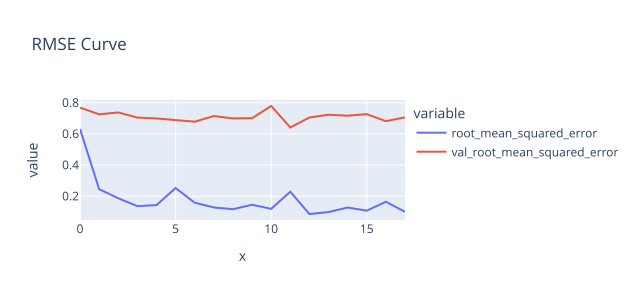

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,0.398958,0.631632,0.590534,0.768462
1,0.060100,0.245152,0.526677,0.725725
2,0.034781,0.186496,0.543793,0.737423
3,0.018498,0.136006,0.496549,0.704663
4,0.020262,0.142345,0.488662,0.699044
5,0.063515,0.252023,0.477382,0.690929
6,0.024903,0.157806,0.459921,0.678175
7,0.016257,0.127502,0.510331,0.714375
8,0.013492,0.116153,0.489083,0.699345
9,0.020951,0.144743,0.490949,0.700678


In [99]:
model_plots_regression(Dropout_history)

#### Neuro Model 
- Neurons in Dense layer increased from 7 to 14

In [100]:
neuro_model = keras.Sequential()

neuro_model.add(layers.Dense(14,input_shape = (14,),activation = 'relu'))
Dropout_model.add(layers.Dropout(0.01))

neuro_model.add(layers.Dense(7,activation = 'relu'))
Dropout_model.add(layers.Dropout(0.01))

neuro_model.add(layers.Dense(1,activation = 'linear'))

In [101]:
neuro_model_history = model_training_regression(neuro_model)

Epoch 78: early stopping
68/68 [==============================] - 0s 1ms/step - loss: 0.4952 - root_mean_squared_error: 0.7037
[0.4951939880847931, 0.7037001848220825]


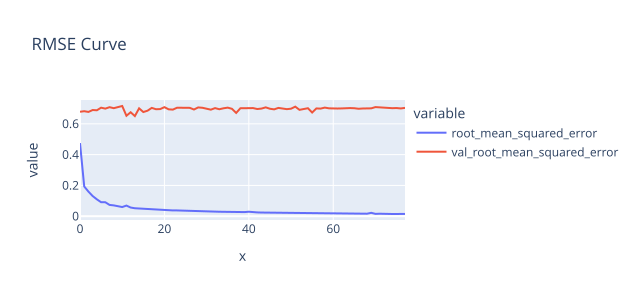

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,0.225602,0.474976,0.460269,0.678431
1,0.037296,0.193121,0.465289,0.682121
2,0.025496,0.159675,0.458965,0.677469
3,0.017129,0.130879,0.475822,0.689798
4,0.011983,0.109468,0.473563,0.688159
...,...,...,...,...
73,0.000205,0.014324,0.491595,0.701138
74,0.000205,0.014325,0.492504,0.701786
75,0.000209,0.014463,0.493880,0.702766
76,0.000208,0.014417,0.490137,0.700098


In [102]:
model_plots_regression(neuro_model_history)

#### Combine model 
- Two layers with 14 and 7 neurons are added respectively.
- L2 regularizer is used in all layers.
- Batch normalisation and dropout layers were added.

In [103]:
combine_model = keras.Sequential()

combine_model.add(layers.Dense(14,input_shape = (14,),activation = 'relu',kernel_regularizer=regularizers.l2(0.001)))
Batch_norm_model.add(layers.BatchNormalization())
combine_model.add(layers.Dropout(0.01))

combine_model.add(layers.Dense(7,activation = 'relu',kernel_regularizer=regularizers.l2(0.001)))
Batch_norm_model.add(layers.BatchNormalization())
combine_model.add(layers.Dropout(0.01))

combine_model.add(layers.Dense(1,activation = 'linear'))

In [104]:
combine_model_history = model_training_regression(combine_model)

Epoch 14: early stopping
68/68 [==============================] - 0s 1ms/step - loss: 0.4723 - root_mean_squared_error: 0.6748
[0.47232139110565186, 0.6748020648956299]


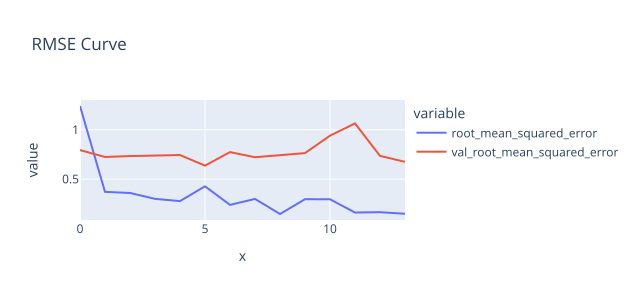

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,1.564564,1.241285,0.654307,0.794038
1,0.160459,0.370530,0.547702,0.724478
2,0.151337,0.359045,0.559916,0.733559
3,0.111222,0.299555,0.561695,0.735161
4,0.097536,0.276665,0.574055,0.743850
5,0.202439,0.426746,0.425212,0.636495
6,0.076575,0.238384,0.618157,0.773736
7,0.108544,0.298731,0.539866,0.721647
8,0.040138,0.145868,0.564757,0.738989
9,0.106053,0.295942,0.601245,0.763518


In [105]:
model_plots_regression(combine_model_history)

#### keras tuner model
- Model tuned and build with keras tuner

In [106]:
import keras_tuner
from tensorflow import keras

In [107]:
tuner = keras_tuner.RandomSearch(
    build_model,
    objective='val_loss', 
    #max_trials=10,
    overwrite = True
    )

In [108]:
tuner.search(x_train, y_train, epochs=100, validation_data=(x_test, y_test))
best_model = tuner.get_best_models()[0]

Trial 3 Complete [00h 01m 23s]
val_loss: 0.4377354383468628

Best val_loss So Far: 0.38297751545906067
Total elapsed time: 00h 04m 08s


In [109]:
tuner.search_space_summary()

Search space summary
Default search space size: 1
units (Choice)
{'default': 12, 'conditions': [], 'values': [12, 14, 16], 'ordered': True}


In [110]:
tuner.results_summary()

Results summary
Results in ./untitled_project
Showing 10 best trials
Trial summary
Hyperparameters:
units: 14
Score: 0.38297751545906067
Trial summary
Hyperparameters:
units: 12
Score: 0.41704797744750977
Trial summary
Hyperparameters:
units: 16
Score: 0.4377354383468628


In [111]:
best_model.build(input_shape = (None,14))
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 14)                210       
                                                                 
 dense_1 (Dense)             (None, 14)                210       
                                                                 
 dense_2 (Dense)             (None, 1)                 15        
                                                                 
Total params: 435
Trainable params: 435
Non-trainable params: 0
_________________________________________________________________


In [112]:
best_hps = tuner.get_best_hyperparameters(1)
tuner_model = build_model(best_hps[0])
tuner_history = tuner_model.fit(x_train, y=y_train, epochs=100,callbacks=callback,validation_data=(x_test, y_test),verbose = 0)

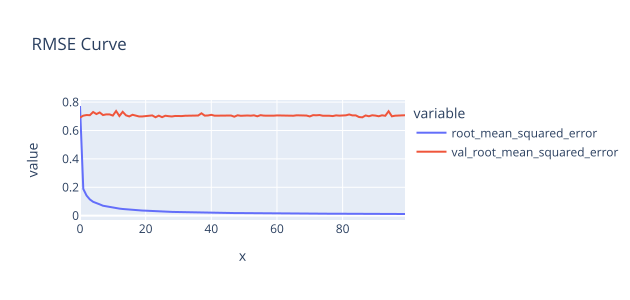

,loss,root_mean_squared_error,val_loss,val_root_mean_squared_error
0,0.596764,0.772505,0.477590,0.691079
1,0.035482,0.188367,0.496392,0.704551
2,0.020004,0.141435,0.502563,0.708917
3,0.013071,0.114327,0.500975,0.707796
4,0.009514,0.097538,0.533036,0.730093
...,...,...,...,...
95,0.000156,0.012486,0.489833,0.699881
96,0.000145,0.012045,0.495884,0.704190
97,0.000138,0.011727,0.497899,0.705619
98,0.000138,0.011727,0.496602,0.704700


In [113]:
model_plots_regression(tuner_history)

# Summary
- Best models were Batch normalisation model and combine model with 0.55 and 0.67 val_rmse respectively when evaluated on test dataset, becuase model had large number of outliers and batch norm makes it normalized. and in combine model 2nd layer is added with batch norm and dropout hence these two performed well other then rest.
- We can also make a dataframe for comparison.
- added each columns outcome to y_test. 

In [114]:
pd.DataFrame({'Base Model': {'Val_loss (mse)': base_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': base_model.evaluate(x_test,y_test,verbose = 0)[1]},
              
              'Tuner Model':{'Val_loss (mse)': tuner_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': tuner_model.evaluate(x_test,y_test,verbose = 0)[1]},

              'Dropout Model': {'Val_loss (mse)': Dropout_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': Dropout_model.evaluate(x_test,y_test,verbose = 0)[1]},

              'Batch Normalization Model': {'Val_loss (mse)': Batch_norm_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': Batch_norm_model.evaluate(x_test,y_test,verbose = 0)[1]},

              'L2 Regularized Model': {'Val_loss (mse)': reg_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': reg_model.evaluate(x_test,y_test,verbose = 0)[1]},

              'Neuro Model': {'Val_loss (mse)': neuro_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': neuro_model.evaluate(x_test,y_test,verbose = 0)[1]},
              
              'Combine Model': {'Val_loss (mse)': combine_model.evaluate(x_test,y_test,verbose = 0)[0], 'val_rmse': combine_model.evaluate(x_test,y_test,verbose = 0)[1]}})

,Base Model,Tuner Model,Dropout Model,Batch Normalization Model,L2 Regularized Model,Neuro Model,Combine Model
Val_loss (mse),0.493963,0.500325,0.498382,0.308015,0.498830,0.495194,0.472321
val_rmse,0.702825,0.707337,0.705962,0.554991,0.705014,0.703700,0.674802


In [115]:
model_prediction_regression(base_model,name = 'Base_model')
model_prediction_regression(neuro_model,name = 'Neuro_model')
model_prediction_regression(combine_model,name = 'combine_model')
model_prediction_regression(Dropout_model,name = 'Dropout_model')
model_prediction_regression(Batch_norm_model,name = 'Batch norm_model')
model_prediction_regression(reg_model,name = 'L2 Regularized model')
model_prediction_regression(tuner_model,name = 'Tuner model')

,Global_Sales,Global_sales_Base_model,Global_sales_Neuro_model,Global_sales_combine_model,Global_sales_Dropout_model,Global_sales_Batch norm_model,Global_sales_L2 Regularized model,Global_sales_Tuner model
5154,0.37,0.428283,0.433060,0.382750,0.401978,0.555743,0.428443,0.426149
8077,0.18,0.290134,0.290580,0.269570,0.270782,0.515519,0.288877,0.294019
10283,0.11,0.228122,0.231510,0.182393,0.219121,0.386776,0.227467,0.231270
5281,0.35,0.419135,0.411659,0.483379,0.417266,0.511306,0.419944,0.427345
5686,0.32,0.491291,0.496335,0.489681,0.466329,0.800046,0.488930,0.485529
...,...,...,...,...,...,...,...,...
6586,0.25,0.418381,0.416307,0.406362,0.441215,0.461218,0.418072,0.408968
8892,0.15,0.265288,0.266308,0.320250,0.254134,0.299296,0.265790,0.237671
4886,0.39,0.441113,0.433005,0.348884,0.439096,0.430540,0.442898,0.437734
8431,0.17,0.336016,0.337759,0.266448,0.331423,0.353632,0.335028,0.328039
